# This ntb looks at foreground images of control group of mice getting to know the typical background fluorescence of mice

Content
* [FRG](#FRG)
  * [Get correction matrices for background and mice](#Get-correction-matrices-for-background-and-mice)
    * [empty slots](#Get-background-on-empty-positions)
    * [average mouse signal accounting for empty slot singal](#Get-the-background-of-mice-accounting-for-the-empty-slot-background)
    * [Do the same on the entire dataset](#Do-the-same-on-the-entire-dataset)

## FRG

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import h5py
import os, sys

# Importing module for simulations checks
functions_modul =  "./functions"
sys.path.insert(0, functions_modul)

from load_h5_into_np import load_h5_into_np


file_path = "/Users/jan/Documents/PhD/Ondra/Ondra_data/control/frg"
files = os.listdir(file_path)

Matrix shape: (1024, 1024)
mean  9.8044815
mean  10.054979
mean  10.44187
mean  14.939251
mean  10.865839
Matrix shape: (1024, 1024)
mean  10.526466
mean  12.044355
mean  12.122571
mean  24.322287
mean  10.763895
Matrix shape: (1024, 1024)
mean  18.684565
mean  23.03764
mean  25.738642
mean  28.000883
mean  19.550142
Matrix shape: (1024, 1024)
mean  10.111833
mean  10.470702
mean  12.681914
mean  19.174654
mean  11.860487
Matrix shape: (1024, 1024)
mean  18.706463
mean  24.386662
mean  25.01861
mean  28.869184
mean  19.463253
Matrix shape: (1024, 1024)
mean  24.449472
mean  28.30136
mean  30.11598
mean  31.219137
mean  25.115551
Matrix shape: (1024, 1024)
mean  10.183178
mean  10.46623
mean  12.906061
mean  22.04746
mean  12.036826
Matrix shape: (1024, 1024)
mean  9.745916
mean  9.911276
mean  11.492251
mean  17.477646
mean  11.408459
Matrix shape: (1024, 1024)
mean  10.706944
mean  10.876489
mean  11.410466
mean  16.238764
mean  11.050076
Matrix shape: (1024, 1024)
mean  23.715683
mea

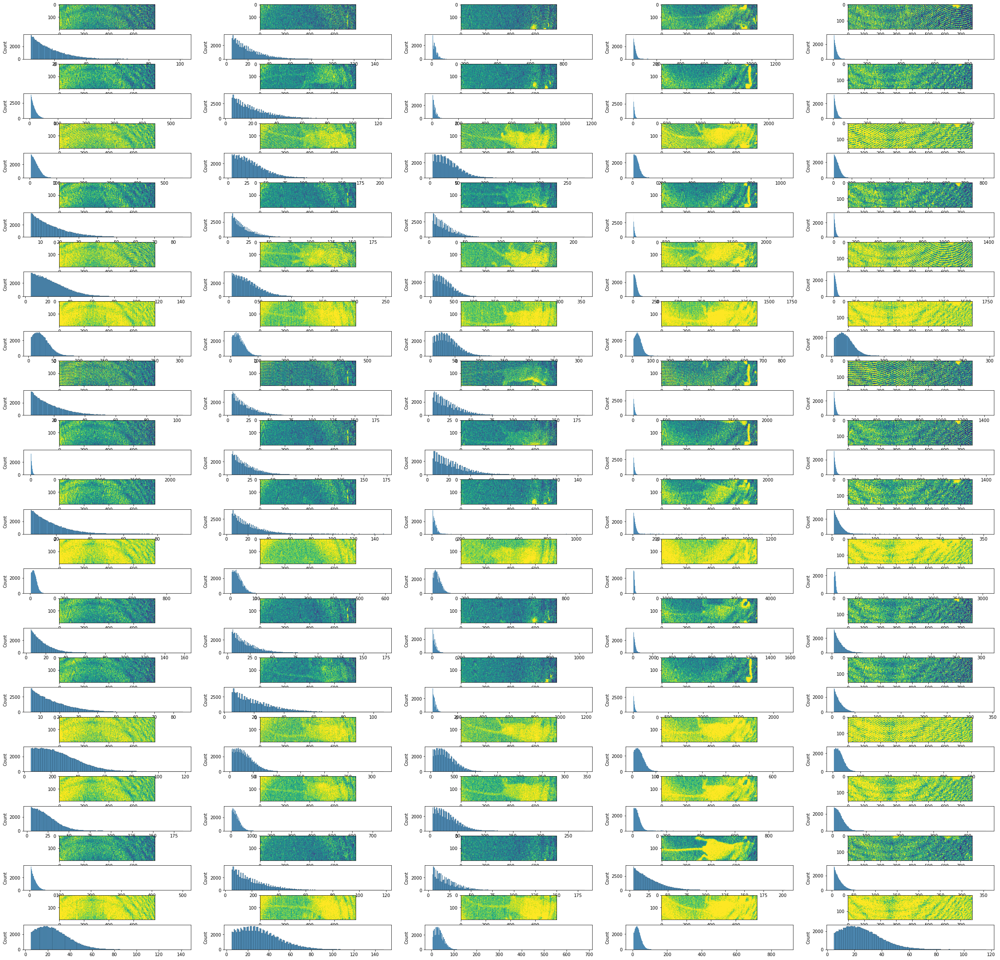

In [2]:
fig, ax = plt.subplots(2 * len(files), 5, figsize=(40, 40))
off = 70
background = 5
bcg_mean_705 = np.zeros((len(files), 5))

for j in range(len(files)):
    # load the arr
    tmp_arr = load_h5_into_np(os.path.join(file_path, files[j]))

    for i in range(5):
        y = tmp_arr[off + (200 * i) : off + (200 * (i + 1)), 250:-1]
        ax[2 * j, i].imshow(y > background)
        #         print('(',off+(200*i),',',off+(200*(i+1)),',',250,',',-1,')')
        print("mean ", y.mean())
        bcg_mean_705[j, i] = y.mean()
        sns.histplot((y[y > background]).reshape(-1), ax=ax[2 * j + 1, i])


plt.savefig(f"frg_control_{off}_th{background}.png")
# plt.savefig(f"frg_control_{off}_th{background}.pdf")

### Get correction matrices for background and mice

Automatic way of detecting mice is not working well because the mouse has such a weak signal that the fourth slot has always the highest intensity regardless whether there is a mouse or not...

Therefore it has to be checked manually, the name is extracted and the position fit based on the name for the individual mouse. 

### Get background on empty positions

Matrix shape: (1024, 1024)
mean  9.8044815
mean  10.054979
mean  10.44187
mean  14.939251
mean  10.865839
Mouse 0 slot 3


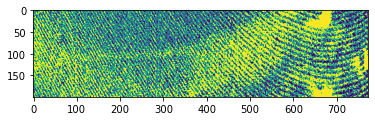

Matrix shape: (1024, 1024)
mean  10.526466
mean  12.044355
mean  12.122571
mean  24.322287
mean  10.763895
Mouse 1 slot 1


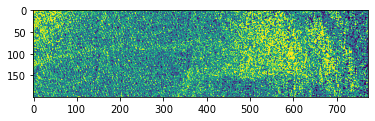

Matrix shape: (1024, 1024)
mean  18.684565
mean  23.03764
mean  25.738642
mean  28.000883
mean  19.550142


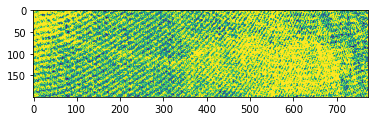

Mouse 2 slot 1


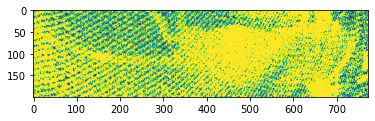

Mouse 2 slot 3


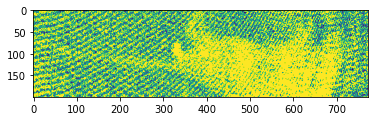

Mouse 2 slot 2
Matrix shape: (1024, 1024)
mean  10.111833
mean  10.470702
mean  12.681914
mean  19.174654
mean  11.860487
Mouse 3 slot 2


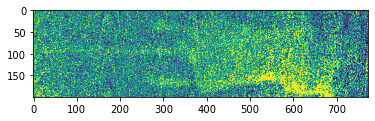

Matrix shape: (1024, 1024)
mean  18.706463
mean  24.386662
mean  25.01861
mean  28.869184
mean  19.463253


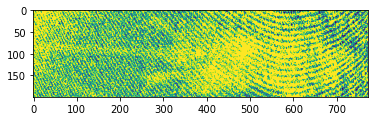

Mouse 4 slot 1


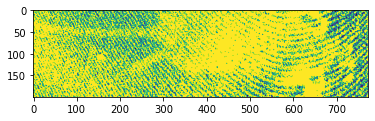

Mouse 4 slot 3


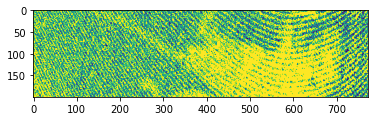

Mouse 4 slot 2
Matrix shape: (1024, 1024)
mean  24.449472
mean  28.30136
mean  30.11598
mean  31.219137
mean  25.115551


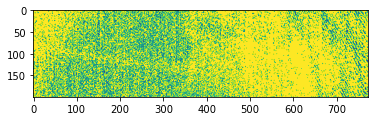

Mouse 5 slot 1


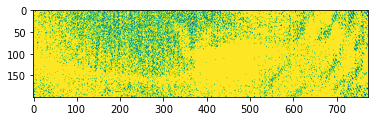

Mouse 5 slot 3


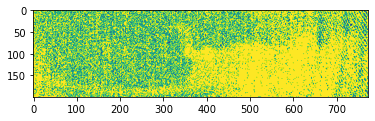

Mouse 5 slot 2
Matrix shape: (1024, 1024)
mean  10.183178
mean  10.46623
mean  12.906061
mean  22.04746
mean  12.036826
Mouse 6 slot 2


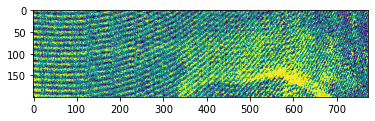

Matrix shape: (1024, 1024)
mean  9.745916
mean  9.911276
mean  11.492251
mean  17.477646
mean  11.408459
Mouse 7 slot 2


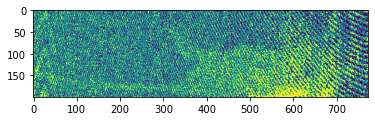

Matrix shape: (1024, 1024)
mean  10.706944
mean  10.876489
mean  11.410466
mean  16.238764
mean  11.050076
Mouse 8 slot 3


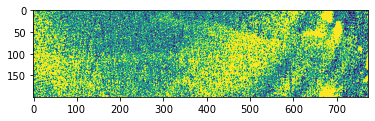

Matrix shape: (1024, 1024)
mean  23.715683
mean  25.072184
mean  30.718645
mean  43.369846
mean  29.492018


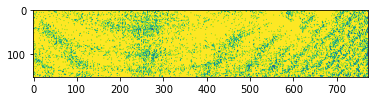

Mouse 9 slot 4


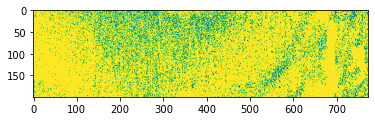

Mouse 9 slot 3


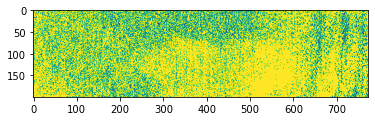

Mouse 9 slot 2
Matrix shape: (1024, 1024)
mean  9.84319
mean  10.145443
mean  10.627637
mean  14.960584
mean  10.146748
Mouse 10 slot 3


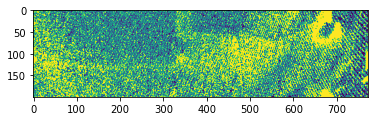

Matrix shape: (1024, 1024)
mean  10.053471
mean  11.489621
mean  11.713826
mean  22.049433
mean  10.054256
Mouse 11 slot 1


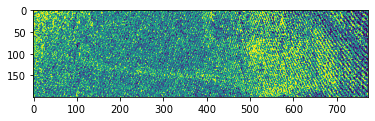

Matrix shape: (1024, 1024)
mean  22.415154
mean  26.570217
mean  28.86991
mean  31.053495
mean  23.017046


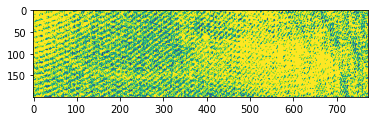

Mouse 12 slot 1


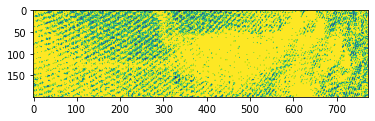

Mouse 12 slot 3


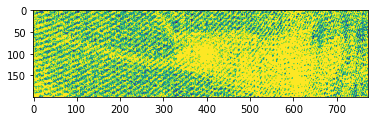

Mouse 12 slot 2
Matrix shape: (1024, 1024)
mean  18.852121
mean  22.74636
mean  24.003345
mean  26.212029
mean  19.041101


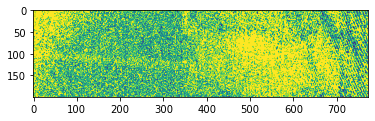

Mouse 13 slot 1


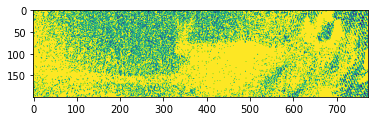

Mouse 13 slot 3


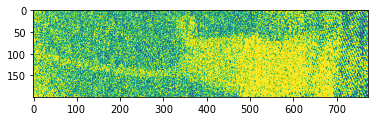

Mouse 13 slot 2
Matrix shape: (1024, 1024)
mean  10.18396
mean  10.360613
mean  10.369593
mean  18.981522
mean  10.476869
Mouse 14 slot 3


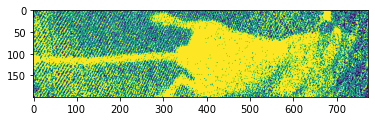

Matrix shape: (1024, 1024)
mean  23.858913
mean  27.780043
mean  29.619635
mean  30.900557
mean  23.97744


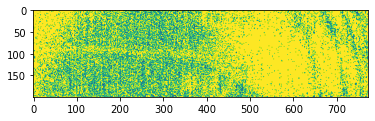

Mouse 15 slot 1


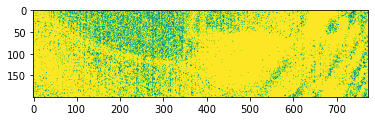

Mouse 15 slot 3


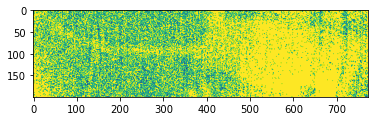

Mouse 15 slot 2


In [3]:
# fig, ax = plt.subplots(2*len(files),5, figsize=(40,40))
off = 70
background = 5
bcg_mean_705 = np.zeros((len(files), 5))

positions = [[], [], [], [], []]


for j, name in enumerate(files):
    # load the arr
    tmp_arr = load_h5_into_np(os.path.join(file_path, files[j]))

    for i in range(5):
        y = tmp_arr[off + (200 * i) : off + (200 * (i + 1)), 250:-1]
        #         plt.imshow(y>background)
        #         print('(',off+(200*i),',',off+(200*(i+1)),',',250,',',-1,')')
        print("mean ", y.mean())
        bcg_mean_705[j, i] = y.mean()
    #         sns.histplot((y[y>background]).reshape(-1), ax=ax[2*j+1,i])

    if "vsechny" in name:
        # get indices of three slots with mice
        # https://stackoverflow.com/questions/6910641/how-do-i-get-indices-of-n-maximum-values-in-a-numpy-array
        inds = np.argpartition(bcg_mean_705[j, :], -3)[-3:]

        # plot full positions
        for k in inds:
            z = tmp_arr[off + (200 * k) : off + (200 * (k + 1)), 250:-1]
            plt.imshow(z > background)
            plt.show()
            print(f"Mouse {j} slot {k}")

        # get the empty positions and append their values to corresponding list
        for empty in set(range(5)) - set(inds):
            positions[empty].append(
                tmp_arr[off + (200 * empty) : off + (200 * (empty + 1)), 250:-1]
            )

    elif "mys" in name:
        # get the position manually, CAUTION!!! Must be checked by a user
        k = int(name.split("_")[5][-1])
        print(f"Mouse {j} slot {k}")
        z = tmp_arr[off + (200 * k) : off + (200 * (k + 1)), 250:-1]
        plt.imshow(z > background)
        plt.show()
        # get the empty positions and append their values to corresponding list
        for empty in set(range(5)) - set(
            [k]
        ):  # k is always an int, so it must be a list
            positions[empty].append(
                tmp_arr[off + (200 * empty) : off + (200 * (empty + 1)), 250:-1]
            )

# create an array of means for each position
correction_matrix_slots_list = np.concatenate(
    [np.asarray(positions[i]).mean(axis=0) for i in range(len(positions))]
)

In [4]:
positions[0]

[array([[14.392074  , 18.065681  , 26.042755  , ..., 28.994448  ,
         19.776491  ,  4.4351983 ],
        [21.82547   ,  6.0398455 ,  2.2106729 , ..., 28.68144   ,
          8.3321495 ,  0.47039506],
        [ 9.919588  , 18.043558  , 33.02073   , ...,  8.349714  ,
         13.509137  , 23.269655  ],
        ...,
        [ 0.5291643 ,  0.7098508 , 10.218286  , ..., 10.833586  ,
          0.47164467,  0.        ],
        [ 1.678899  ,  2.7506926 , 22.893024  , ..., 13.405155  ,
          0.35670608,  9.891803  ],
        [11.722553  ,  4.902771  , 24.749855  , ...,  0.        ,
          0.        , 14.273436  ]], dtype=float32),
 array([[9.5217609e+00, 3.7062199e+01, 1.3175367e+01, ..., 1.5064383e+01,
         1.3654886e+01, 9.8759460e+00],
        [3.0745094e+00, 2.1956778e+01, 8.4549465e+00, ..., 2.5641684e+01,
         8.4601898e+00, 9.6293459e+00],
        [2.3510808e-01, 1.0701283e+01, 6.2482686e+00, ..., 2.4093937e+01,
         4.8316331e+00, 7.3214755e+00],
        ...,
   

(954, 773)


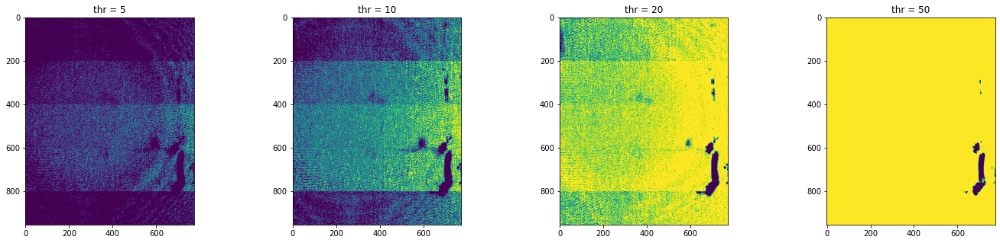

In [5]:
correction_matrix_slots = np.concatenate(
    [np.asarray(positions[i]).mean(axis=0) for i in range(len(positions))]
)
print(correction_matrix_slots.shape)

# plot the data with different thresholds
fig, axs = plt.subplots(ncols=4, figsize=(24, 5))

thr_list = [5, 10, 20, 50]

for thr, ax in zip(thr_list, axs.flatten()):
    ax.imshow(correction_matrix_slots < thr)
    ax.set_title(f"thr = {thr}")

### Get the background of mice accounting for the empty slot background

In [6]:
# fig, ax = plt.subplots(2*len(files),5, figsize=(40,40))
off = 70
background = 5
bcg_mean_705 = np.zeros((len(files), 5))

# get average signal on mice
m_positions = [[], [], [], [], []]

for j, name in enumerate(files):
    # load the arr
    tmp_arr = load_h5_into_np(os.path.join(file_path, files[j]))

    for i in range(5):
        y = tmp_arr[off + (200 * i) : off + (200 * (i + 1)), 250:-1]
        # correct for the given slot
        y -= correction_matrix_slots[(200 * i) : (200 * (i + 1)), :]
        # remove negative values
        y[y < 0] = 0

        #         plt.imshow(y>background)
        print("mean ", y.mean())
        bcg_mean_705[j, i] = y.mean()
    #         sns.histplot((y[y>background]).reshape(-1), ax=ax[2*j+1,i])

    if "vsechny" in name:
        # get indices of three slots with mice
        # https://stackoverflow.com/questions/6910641/how-do-i-get-indices-of-n-maximum-values-in-a-numpy-array
        inds = np.argpartition(bcg_mean_705[j, :], -3)[-3:]

        # plot full positions
        for k in inds:
            z = tmp_arr[off + (200 * k) : off + (200 * (k + 1)), 250:-1]
            #             plt.imshow(z>background)
            print(f"Mouse {j} slot {k}")
            #             plt.show()

            # get the full positions and append their values to corresponding list
            m_positions[k].append(z)

    elif "mys" in name:
        # get the position manually, CAUTION!!! Must be checked by a user
        k = int(name.split("_")[5][-1])
        print(f"Mouse {j} slot {k}")
        z = tmp_arr[off + (200 * k) : off + (200 * (k + 1)), 250:-1]
        #         plt.imshow(z>background)
        #         plt.show()
        # get the empty positions and append their values to corresponding list
        m_positions[k].append(z)


# create an array of means for each position if mouse exist, else use background signal
correction_matrix_slots_mice_list = np.concatenate(
    [
        np.asarray(m_positions[i]).mean(axis=0)
        if m_positions[i]
        else np.asarray(positions[i]).mean(axis=0)
        for i in range(len(m_positions))
    ]
)

Matrix shape: (1024, 1024)
mean  2.192711
mean  3.7456787
mean  4.5296345
mean  7.811905
mean  2.8011308
Mouse 0 slot 3
Matrix shape: (1024, 1024)
mean  2.3285716
mean  5.486581
mean  5.6187987
mean  10.938362
mean  2.605205
Mouse 1 slot 1
Matrix shape: (1024, 1024)
mean  7.0470085
mean  13.719445
mean  17.60229
mean  17.629692
mean  7.7165475
Mouse 2 slot 1
Mouse 2 slot 3
Mouse 2 slot 2
Matrix shape: (1024, 1024)
mean  2.064688
mean  3.8135135
mean  6.8972898
mean  6.081593
mean  3.320925
Mouse 3 slot 2
Matrix shape: (1024, 1024)
mean  7.02596
mean  14.884408
mean  16.96882
mean  19.393187
mean  7.960795
Mouse 4 slot 1
Mouse 4 slot 3
Mouse 4 slot 2
Matrix shape: (1024, 1024)
mean  11.001638
mean  17.965656
mean  21.230122
mean  20.352
mean  11.600175
Mouse 5 slot 1
Mouse 5 slot 3
Mouse 5 slot 2
Matrix shape: (1024, 1024)
mean  2.38611
mean  3.9588568
mean  7.2894816
mean  8.620215
mean  3.73473
Mouse 6 slot 2
Matrix shape: (1024, 1024)
mean  2.1225052
mean  3.6058676
mean  6.1792355
m

### Use max instead of mean to get the background signal -- eventually not used and not implemented

How this works is that it subtracts the background noise but only to get the mean of that and subsequently take the slots with highest remaining mean (assuming that we removed the bacground). BUT the signal is taken from the original matrix, ie WITHOUT the background subtraction which means that it has BOTH the mouse and the background accounted for.

The problem is that the location of the specs are not fixed and move a bit. If that happens, the algorithm fails on that (see New way below). A solution would be to take max value in the background instead of a mean, that should remove the entire background.


The full cleaning, and I'm getting more and more positive about that, should be that:
1) take the background in all empty slots, take its max. Does not have to be on controls only, could actually be done on the entire dataset (that should work because the mouse selection there is much easier -- their intensities are much higher so it's gonna be easy enough to pick the spots automatically and not have false positive with the spill; a workaround is to take only the 3 mice pictures). This will serve as the correction matrix for background. Why to take max and not mean or whatever else? In short, the positins of the mice/slots/device are not constant and shift a bit in space. That means that if we then take mean, the actuall values are diminished and the leftovers after subtracton can still cause the artefact we want to prevent. See the example above. However, max will cover this possibility because if we have enough of images for the background, it will hopefully cover all possible position and then the max will appear in the correction matrix. The price for that is being too harsh and potentially losing signal by subtracting it -- but it's a region we don't care about.

2) Having that, one should take the *control* group only. For each image and slot subtract the corresponding max background (of the given slot), take the slot with a mouse and average those out. I'm unsure here if one should still do it slot specific (still accounts for some local problems) or average across slots (better statistics) but probably the first. This will give a background specific to a mouse on a given position (or generally a mouse) without the background! Again, WITHOUT A BACKGROUND, must be subtracted, not like before. That will yield a mouse specific correction matrix.

3) When doing the analysis, one should load and image, sutract background AND a mouse on a given position and proceed with the analysis.

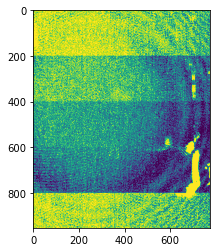

In [7]:
# create an array of means for each position
correction_matrix_slots_list_max = np.concatenate(
    [np.asarray(positions[i]).max(axis=0) for i in range(len(positions))]
)
plt.imshow(correction_matrix_slots_list_max>30)

### Do the same on the entire dataset

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import h5py
import os

# all_files_path = "/Users/jan/Documents/PhD/Ondra/Ondra_data/frg-h5"
# all_files_path = "/Users/jan/Documents/PhD/Ondra/Ondra_data/frg-h5-old"
all_files_path = "/Users/jan/Documents/PhD/Ondra/Ondra_data/frg"
all_files = os.listdir(all_files_path)
control_files = [x for x in all_files if "kontrola" in x]
control_files

['im9_pondeli_01_kontrola01_dmso_mys03_bricho_00h_2020-09-07_10-17-22-MWL-Ex(750)-Em(830)_Frgrnd.h5',
 'im750_utery_11_kontrola02_dmso_vsechny_p_bok_05h_2020-09-08_19-37-47-MWL-Ex(750)-Em(830)_Frgrnd.h5',
 'im15_pondeli_01_kontrola01_dmso_vsechny_l_bok_d150_2021-02-09_13-51-56-MWL-Ex(750)-Em(830)_Frgrnd.h5',
 'im28_pondeli_01_kontrola01_dmso_vsechny_p_bok_d85_2020-12-01_12-23-22-MWL-Ex(750)-Em(830)_Frgrnd.h5',
 'im14_pondeli_01_kontrola01_dmso_vsechny_bricho_d245_2021-05-12_13-21-32-MWL-Ex(750)-Em(830)_Frgrnd.h5',
 'im13_pondeli_01_kontrola01_dmso_vsechny_bricho_d150_2021-02-09_13-42-12-MWL-Ex(750)-Em(830)_Frgrnd.h5',
 'im6_pondeli_01_kontrola01_dmso_mys02_bricho_00h_2020-09-07_09-55-26-MWL-Ex(750)-Em(830)_Frgrnd.h5',
 'im745_utery_11_kontrola02_dmso_vsechny_l_bok_00h_2020-09-08_18-50-51-MWL-Ex(750)-Em(830)_Frgrnd.h5',
 'im8_pondeli_01_kontrola01_dmso_mys02_p_bok_00h_2020-09-07_09-58-06-MWL-Ex(750)-Em(830)_Frgrnd.h5',
 'im749_utery_11_kontrola02_dmso_vsechny_p_bok_00h_2020-09-08_18-48-

In [9]:
# check shape
for j, name in enumerate(control_files):
    # load the arr
    tmp_arr = load_h5_into_np(os.path.join(all_files_path, control_files[j]))
    if tmp_arr.shape != (1024, 1024):
        print("\n\n", name, "\n\n")

Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (2048, 2048)


 im753_utery_11_kontrola02_dmso_vsechny_p_bok_72h_2020-09-11_09-45-27-MWL-Ex(750)-Em(830)_Frgrnd.h5 


Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matrix shape: (1024, 1024)
Matr

Matrix shape: (1024, 1024)
mean  10.18396
mean  10.360613
mean  10.369593
mean  18.981522
mean  10.476869
Mouse 0 slot 3


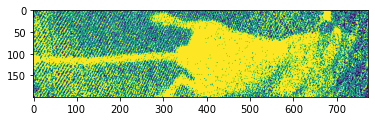

Matrix shape: (1024, 1024)
mean  18.38598
mean  23.484917
mean  26.44898
mean  27.81051
mean  19.502573
Mouse 1 slot 1


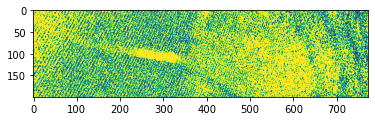

Mouse 1 slot 3


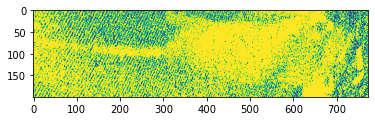

Mouse 1 slot 2


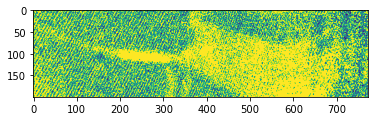

Matrix shape: (1024, 1024)
mean  20.530457
mean  25.231674
mean  26.91526
mean  29.840715
mean  21.166046
Mouse 2 slot 1


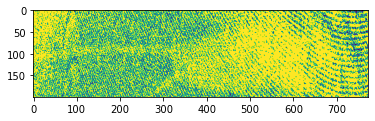

Mouse 2 slot 3


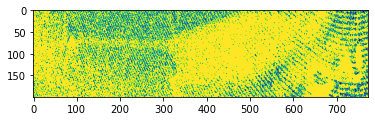

Mouse 2 slot 2


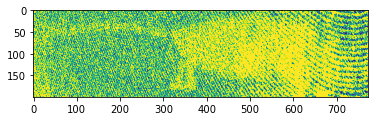

Matrix shape: (1024, 1024)
mean  19.663052
mean  23.720366
mean  25.43929
mean  27.566118
mean  19.61981
Mouse 3 slot 1


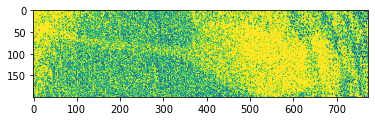

Mouse 3 slot 3


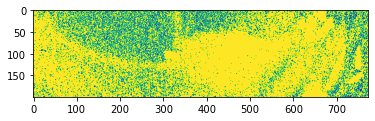

Mouse 3 slot 2


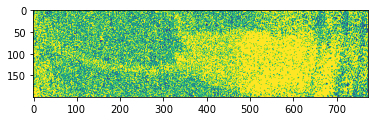

Matrix shape: (1024, 1024)
mean  16.543364
mean  17.454319
mean  24.166477
mean  23.828657
mean  16.503736
Mouse 4 slot 1


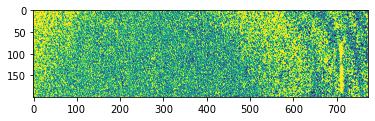

Mouse 4 slot 3


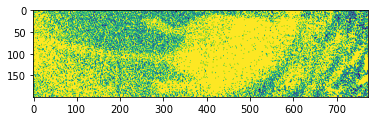

Mouse 4 slot 2


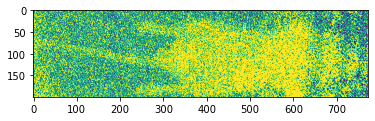

Matrix shape: (1024, 1024)
mean  21.087677
mean  26.798395
mean  29.729818
mean  33.09146
mean  21.792498
Mouse 5 slot 1


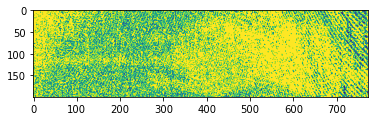

Mouse 5 slot 3


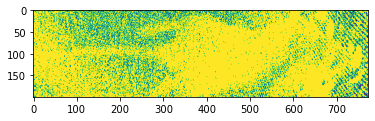

Mouse 5 slot 2


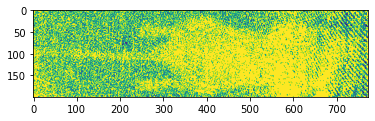

Matrix shape: (1024, 1024)
mean  10.111833
mean  10.470702
mean  12.681914
mean  19.174654
mean  11.860487
Mouse 6 slot 2


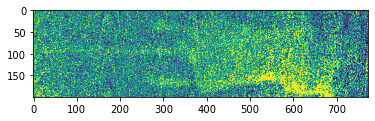

Matrix shape: (1024, 1024)
mean  18.50213
mean  23.261183
mean  26.262156
mean  29.841885
mean  21.437418
Mouse 7 slot 1


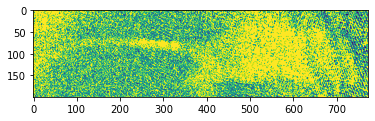

Mouse 7 slot 3


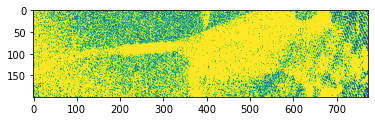

Mouse 7 slot 2


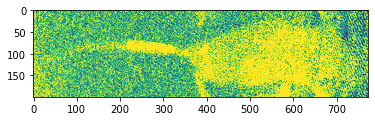

Matrix shape: (1024, 1024)
mean  9.745916
mean  9.911276
mean  11.492251
mean  17.477646
mean  11.408459
Mouse 8 slot 2


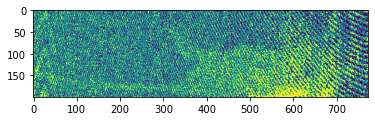

Matrix shape: (1024, 1024)
mean  18.919292
mean  24.001768
mean  26.723925
mean  28.33652
mean  19.901085
Mouse 9 slot 1


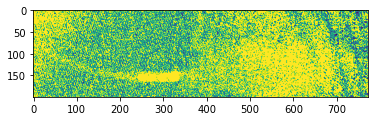

Mouse 9 slot 3


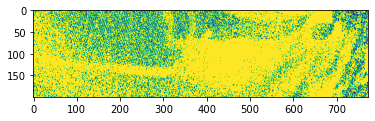

Mouse 9 slot 2


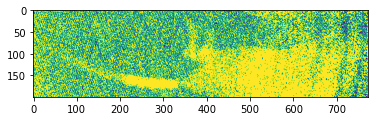

Matrix shape: (1024, 1024)
mean  9.8044815
mean  10.054979
mean  10.44187
mean  14.939251
mean  10.865839
Mouse 10 slot 3


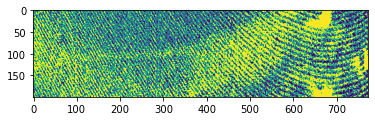

Matrix shape: (1024, 1024)
mean  15.788302
mean  19.723915
mean  20.88082
mean  22.796206
mean  15.7885475
Mouse 11 slot 1


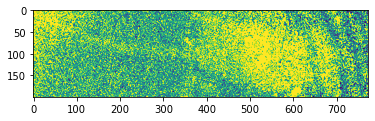

Mouse 11 slot 3


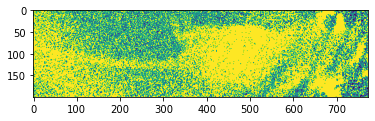

Mouse 11 slot 2


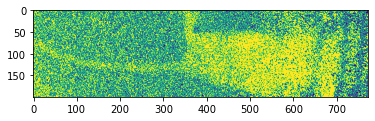

Matrix shape: (1024, 1024)
mean  23.858913
mean  27.780043
mean  29.619635
mean  30.900557
mean  23.97744
Mouse 12 slot 1


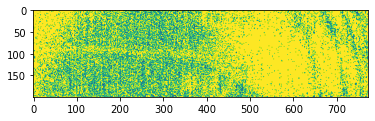

Mouse 12 slot 3


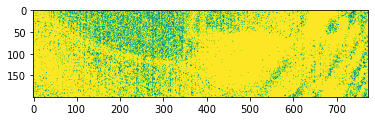

Mouse 12 slot 2


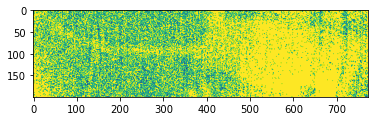

Matrix shape: (1024, 1024)
mean  16.91845
mean  20.125664
mean  21.586958
mean  24.37195
mean  17.38129
Mouse 13 slot 1


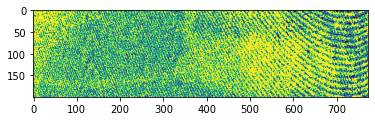

Mouse 13 slot 3


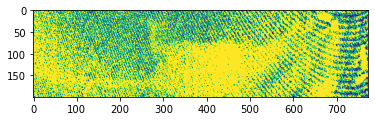

Mouse 13 slot 2


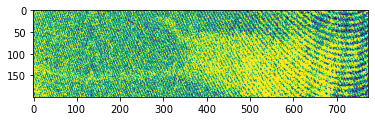

Matrix shape: (1024, 1024)
mean  19.975237
mean  25.325495
mean  27.809986
mean  30.581022
mean  20.265114
Mouse 14 slot 1


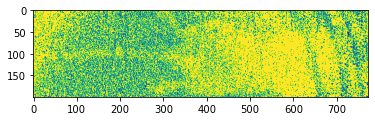

Mouse 14 slot 3


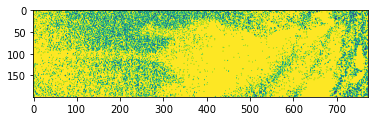

Mouse 14 slot 2


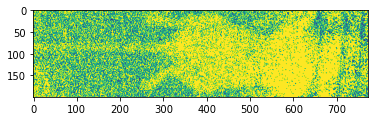

Matrix shape: (1024, 1024)
mean  17.647924
mean  22.139626
mean  24.119034
mean  25.259579
mean  17.938295
Mouse 15 slot 1


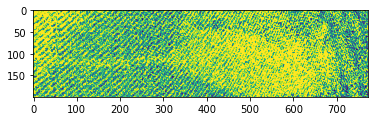

Mouse 15 slot 3


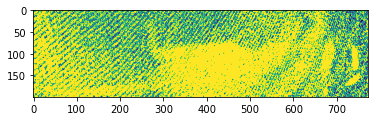

Mouse 15 slot 2


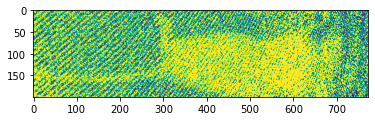

Matrix shape: (1024, 1024)
mean  10.053471
mean  11.489621
mean  11.713826
mean  22.049433
mean  10.054256
Mouse 16 slot 1


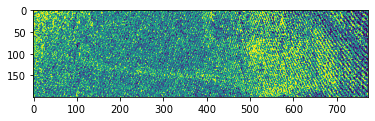

Matrix shape: (1024, 1024)
mean  22.708286
mean  27.72224
mean  31.284773
mean  32.16874
mean  24.201303
Mouse 17 slot 1


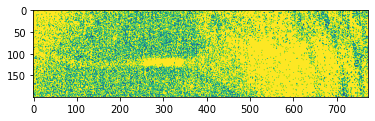

Mouse 17 slot 3


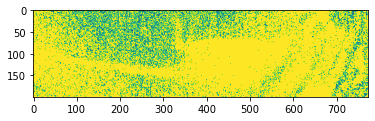

Mouse 17 slot 2


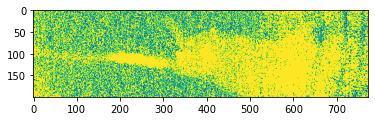

Matrix shape: (1024, 1024)
mean  17.91641
mean  15.470266
mean  20.799936
mean  24.716108
mean  19.789457
Mouse 18 slot 4


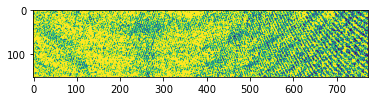

Mouse 18 slot 3


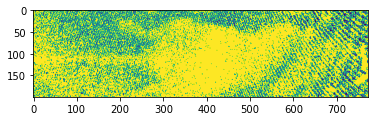

Mouse 18 slot 2


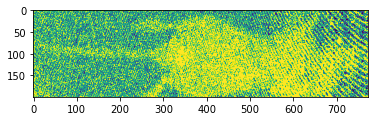

Matrix shape: (1024, 1024)
mean  10.706944
mean  10.876489
mean  11.410466
mean  16.238764
mean  11.050076
Mouse 19 slot 3


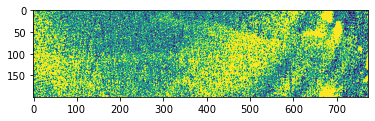

Matrix shape: (1024, 1024)
mean  18.684565
mean  23.03764
mean  25.738642
mean  28.000883
mean  19.550142
Mouse 20 slot 1


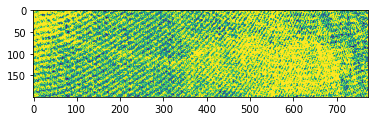

Mouse 20 slot 3


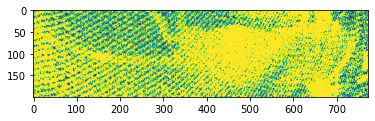

Mouse 20 slot 2


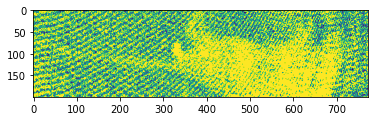

Matrix shape: (1024, 1024)
mean  10.183178
mean  10.46623
mean  12.906061
mean  22.04746
mean  12.036826
Mouse 21 slot 2


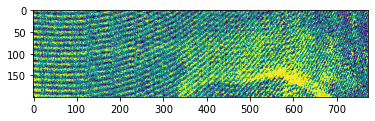

Matrix shape: (1024, 1024)
mean  17.981705
mean  21.3596
mean  22.681135
mean  24.78641
mean  18.269989
Mouse 22 slot 1


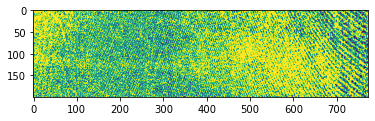

Mouse 22 slot 3


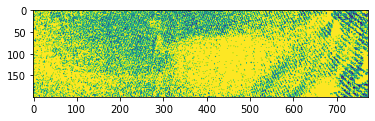

Mouse 22 slot 2


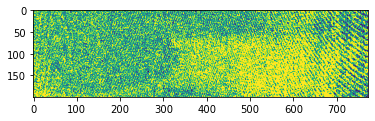

Matrix shape: (1024, 1024)
mean  19.207949
mean  23.161135
mean  24.862926
mean  27.409414
mean  18.943752
Mouse 23 slot 1


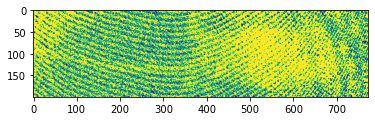

Mouse 23 slot 3


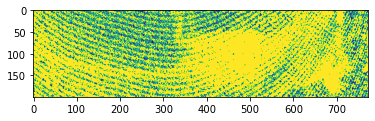

Mouse 23 slot 2


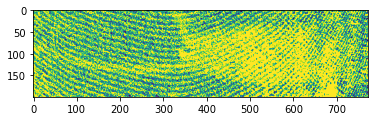

Matrix shape: (1024, 1024)
mean  24.654428
mean  28.770721
mean  30.383968
mean  30.579748
mean  24.753649
Mouse 24 slot 1


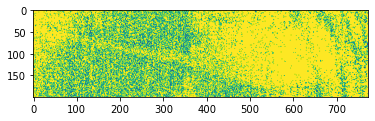

Mouse 24 slot 3


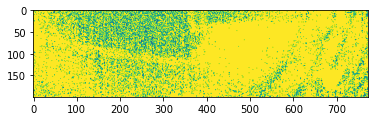

Mouse 24 slot 2


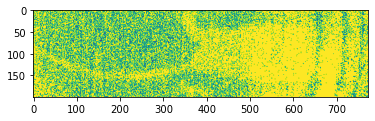

Matrix shape: (1024, 1024)
mean  16.05495
mean  16.911383
mean  22.24463
mean  22.82789
mean  16.201452
Mouse 25 slot 1


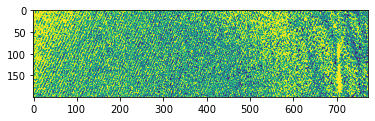

Mouse 25 slot 3


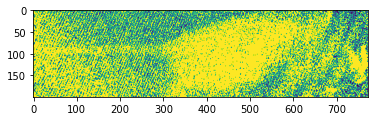

Mouse 25 slot 2


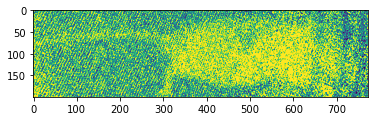

Matrix shape: (2048, 2048)
Matrix shape: (1024, 1024)
mean  17.45423
mean  19.667913
mean  23.026384
mean  39.788166
mean  17.65656
Mouse 27 slot 1


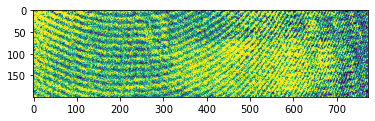

Mouse 27 slot 3


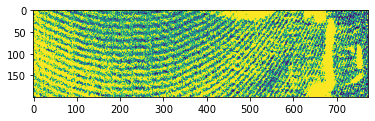

Mouse 27 slot 2


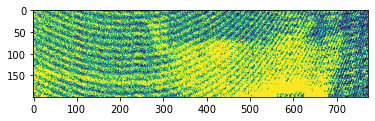

Matrix shape: (1024, 1024)
mean  16.422693
mean  17.252836
mean  22.736362
mean  22.634993
mean  16.47415
Mouse 28 slot 1


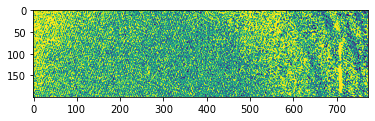

Mouse 28 slot 3


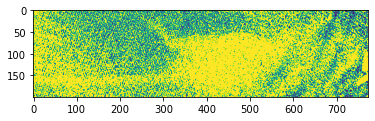

Mouse 28 slot 2


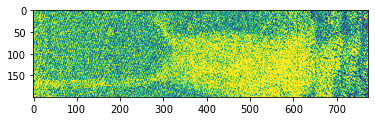

Matrix shape: (1024, 1024)
mean  9.84319
mean  10.145443
mean  10.627637
mean  14.960584
mean  10.146748
Mouse 29 slot 3


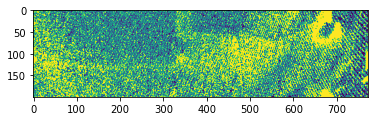

Matrix shape: (1024, 1024)
mean  17.106985
mean  17.689781
mean  22.929047
mean  23.709251
mean  17.044596
Mouse 30 slot 1


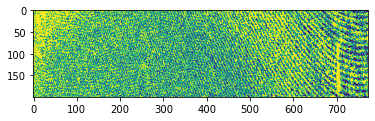

Mouse 30 slot 3


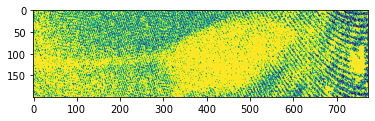

Mouse 30 slot 2


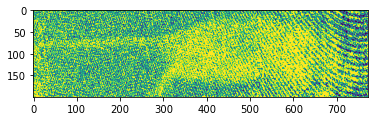

Matrix shape: (1024, 1024)
mean  18.852121
mean  22.74636
mean  24.003345
mean  26.212029
mean  19.041101
Mouse 31 slot 1


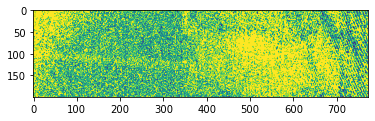

Mouse 31 slot 3


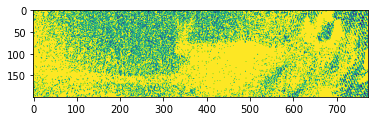

Mouse 31 slot 2


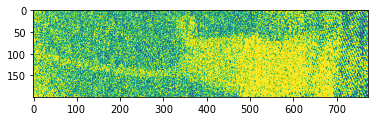

Matrix shape: (1024, 1024)
mean  23.292631
mean  27.277212
mean  29.280779
mean  30.089325
mean  23.389755
Mouse 32 slot 1


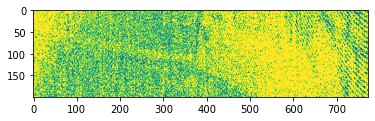

Mouse 32 slot 3


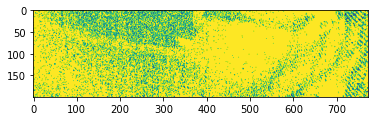

Mouse 32 slot 2


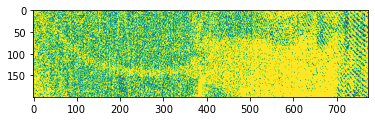

Matrix shape: (1024, 1024)
mean  19.517517
mean  23.779554
mean  25.902626
mean  29.131527
mean  19.62313
Mouse 33 slot 1


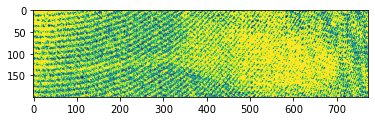

Mouse 33 slot 3


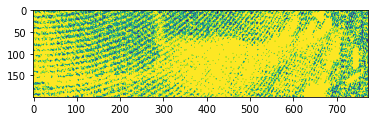

Mouse 33 slot 2


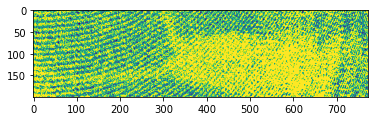

Matrix shape: (1024, 1024)
mean  24.449472
mean  28.30136
mean  30.11598
mean  31.219137
mean  25.115551
Mouse 34 slot 1


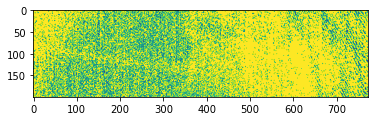

Mouse 34 slot 3


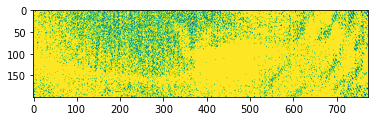

Mouse 34 slot 2


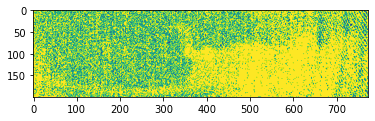

Matrix shape: (1024, 1024)
mean  19.153708
mean  23.428774
mean  25.204746
mean  33.395493
mean  20.289078
Mouse 35 slot 1


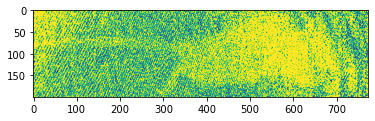

Mouse 35 slot 3


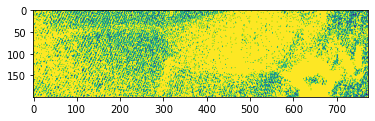

Mouse 35 slot 2


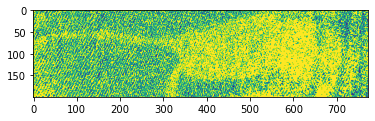

Matrix shape: (1024, 1024)
mean  20.044804
mean  24.579708
mean  26.244379
mean  28.90259
mean  20.462753
Mouse 36 slot 1


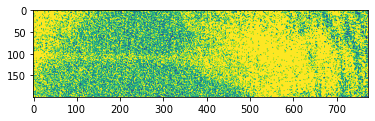

Mouse 36 slot 3


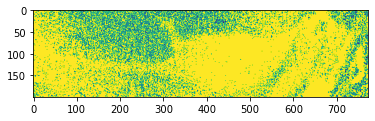

Mouse 36 slot 2


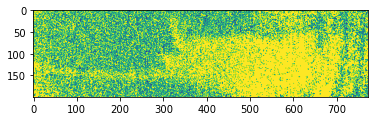

Matrix shape: (1024, 1024)
mean  17.729155
mean  19.62331
mean  23.872093
mean  41.511265
mean  18.725939
Mouse 37 slot 1


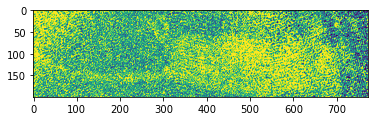

Mouse 37 slot 3


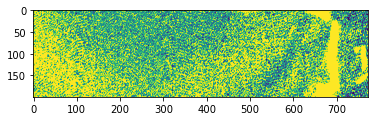

Mouse 37 slot 2


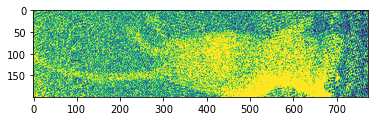

Matrix shape: (1024, 1024)
mean  17.856195
mean  20.047417
mean  23.548172
mean  40.30814
mean  18.713808
Mouse 38 slot 1


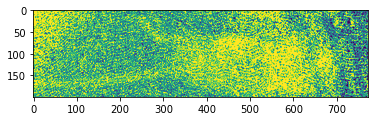

Mouse 38 slot 3


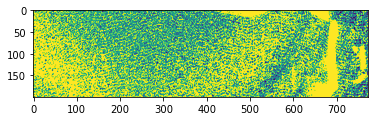

Mouse 38 slot 2


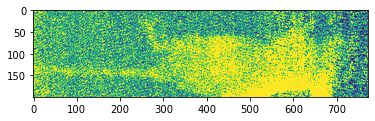

Matrix shape: (1024, 1024)
mean  10.184719
mean  11.932031
mean  11.829642
mean  23.610598
mean  10.429368
Mouse 39 slot 1


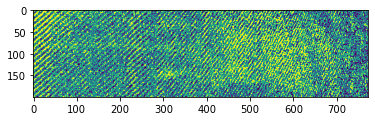

Matrix shape: (1024, 1024)
mean  17.315561
mean  18.256588
mean  23.73014
mean  25.333551
mean  17.476501
Mouse 40 slot 1


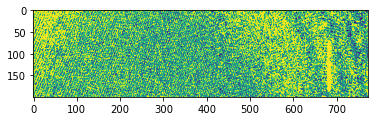

Mouse 40 slot 3


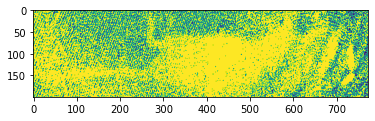

Mouse 40 slot 2


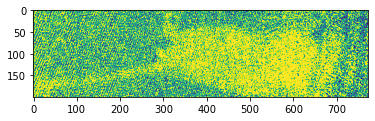

Matrix shape: (1024, 1024)
mean  18.670229
mean  23.692568
mean  27.371708
mean  35.56876
mean  22.047546
Mouse 41 slot 1


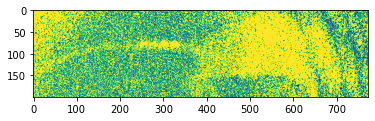

Mouse 41 slot 3


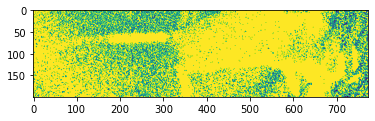

Mouse 41 slot 2


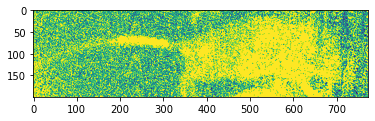

Matrix shape: (1024, 1024)
mean  10.526466
mean  12.044355
mean  12.122571
mean  24.322287
mean  10.763895
Mouse 42 slot 1


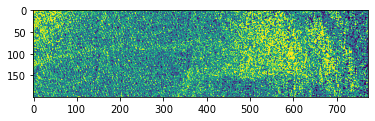

Matrix shape: (1024, 1024)
mean  22.415154
mean  26.570217
mean  28.86991
mean  31.053495
mean  23.017046
Mouse 43 slot 1


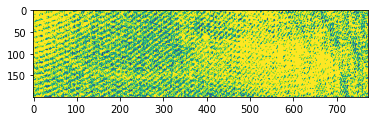

Mouse 43 slot 3


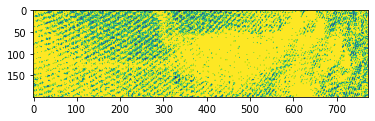

Mouse 43 slot 2


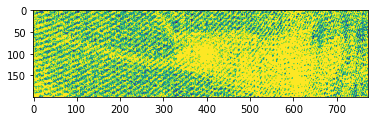

Matrix shape: (1024, 1024)
mean  19.791077
mean  24.283783
mean  26.956057
mean  28.342012
mean  20.17614
Mouse 44 slot 1


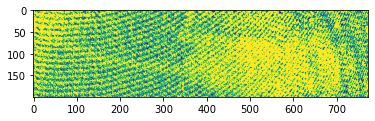

Mouse 44 slot 3


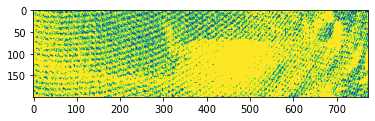

Mouse 44 slot 2


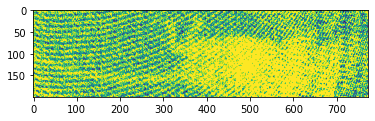

Matrix shape: (1024, 1024)
mean  16.706207
mean  17.361647
mean  22.659727
mean  23.488676
mean  16.954872
Mouse 45 slot 1


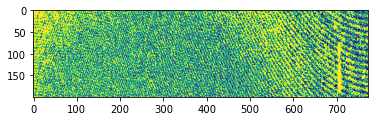

Mouse 45 slot 3


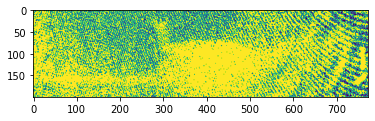

Mouse 45 slot 2


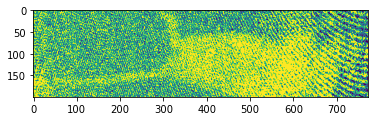

Matrix shape: (1024, 1024)
mean  21.341206
mean  26.207539
mean  28.201452
mean  29.398273
mean  21.776669
Mouse 46 slot 1


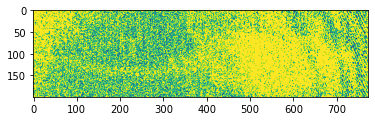

Mouse 46 slot 3


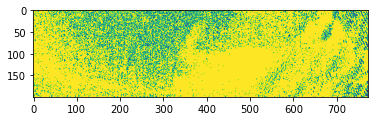

Mouse 46 slot 2


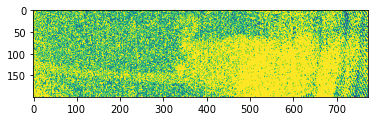

Matrix shape: (1024, 1024)
mean  24.326242
mean  28.806223
mean  30.556614
mean  32.673347
mean  25.172604
Mouse 47 slot 1


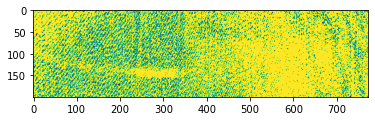

Mouse 47 slot 3


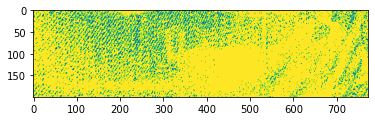

Mouse 47 slot 2


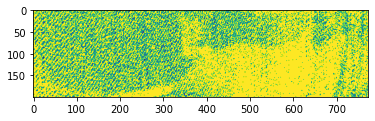

In [10]:
# fig, ax = plt.subplots(2*len(files),5, figsize=(40,40))
off = 70
background = 5
positions_all = [[], [], [], [], []]
bcg_mean_705 = np.zeros((len(control_files), len(positions_all)))

for j, name in enumerate(control_files):
    # load the arr
    tmp_arr = load_h5_into_np(os.path.join(all_files_path, control_files[j]))
    # loop only over correct shape
    if tmp_arr.shape == (1024, 1024):
        for i in range(5):
            y = tmp_arr[off + (200 * i) : off + (200 * (i + 1)), 250:-1]
            #             plt.imshow(y>background)
            #         print('(',off+(200*i),',',off+(200*(i+1)),',',250,',',-1,')')
            print("mean ", y.mean())
            bcg_mean_705[j, i] = y.mean()
        #         sns.histplot((y[y>background]).reshape(-1), ax=ax[2*j+1,i])

        if "vsechny" in name:
            # get indices of three slots with mice
            # https://stackoverflow.com/questions/6910641/how-do-i-get-indices-of-n-maximum-values-in-a-numpy-array
            inds = np.argpartition(bcg_mean_705[j, :], -3)[-3:]

            # plot full positions
            for k in inds:
                print(f"Mouse {j} slot {k}")
                z = tmp_arr[off + (200 * k) : off + (200 * (k + 1)), 250:-1]
                plt.imshow(z > background)
                plt.show()

            # get the empty positions and append their values to corresponding list
            for empty in set(range(5)) - set(inds):
                positions_all[empty].append(
                    tmp_arr[off + (200 * empty) : off + (200 * (empty + 1)), 250:-1]
                )

        elif "mys" in name:
            # get the position manually, CAUTION!!! Must be checked by a user
            k = int(name.split("_")[5][-1])
            print(f"Mouse {j} slot {k}")
            z = tmp_arr[off + (200 * k) : off + (200 * (k + 1)), 250:-1]
            plt.imshow(z > background)
            plt.show()
            # get the empty positions and append their values to corresponding list
            for empty in set(range(5)) - set(
                [k]
            ):  # k is always an int, so it must be a list
                positions_all[empty].append(
                    tmp_arr[off + (200 * empty) : off + (200 * (empty + 1)), 250:-1]
                )

(954, 773)


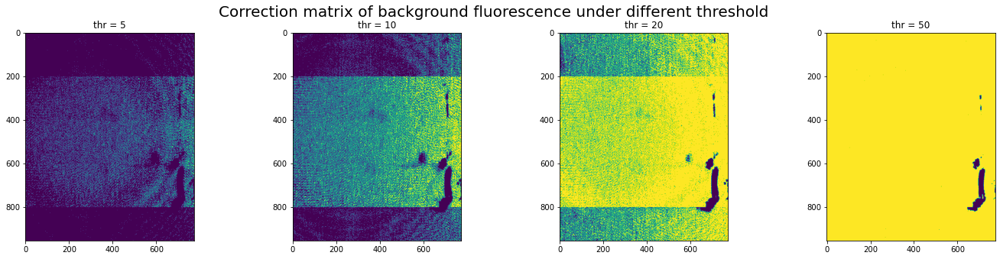

In [11]:
# create an array of means for each position
correction_matrix_slots_all = np.concatenate(
    [np.asarray(positions_all[i]).mean(axis=0) for i in range(len(positions_all))]
)

print(correction_matrix_slots_all.shape)

# plot the data with different thresholds
fig, axs = plt.subplots(ncols=4, figsize=(24, 5))

thr_list = [5, 10, 20, 50]

for thr, ax in zip(thr_list, axs.flatten()):
    ax.imshow(correction_matrix_slots_all < thr)
    ax.set_title(f"thr = {thr}")
plt.suptitle(
    "Correction matrix of background fluorescence under different threshold",
    fontsize=20,
)
plt.show()

Matrix shape: (1024, 1024)
mean  2.2653167
mean  3.8429132
mean  4.473465
mean  11.289138
mean  2.4795096
Mouse 0 slot 3


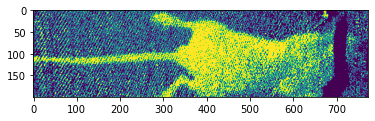

Matrix shape: (1024, 1024)
mean  7.0773206
mean  14.136735
mean  18.253723
mean  18.116505
mean  8.219219
Mouse 1 slot 1


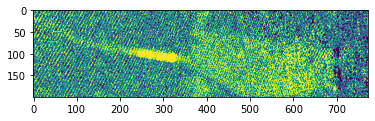

Mouse 1 slot 3


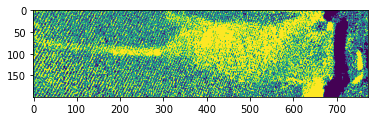

Mouse 1 slot 2


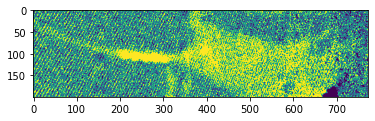

Matrix shape: (1024, 1024)
mean  8.522405
mean  15.50352
mean  18.496819
mean  19.399853
mean  9.344578
Mouse 2 slot 1


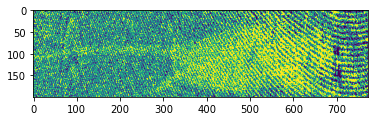

Mouse 2 slot 3


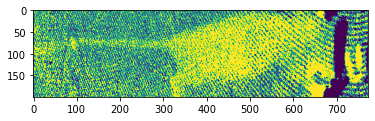

Mouse 2 slot 2


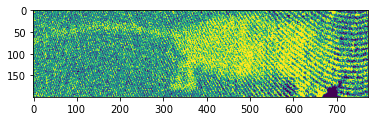

Matrix shape: (1024, 1024)
mean  7.583338
mean  14.117617
mean  17.158527
mean  17.683212
mean  7.728967
Mouse 3 slot 1


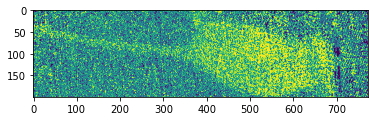

Mouse 3 slot 3


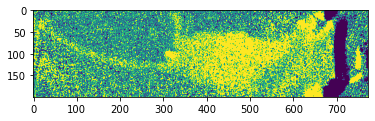

Mouse 3 slot 2


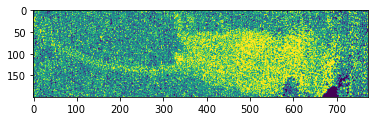

Matrix shape: (1024, 1024)
mean  5.7478786
mean  9.263383
mean  16.20069
mean  14.651038
mean  5.8957524
Mouse 4 slot 1


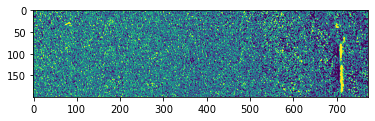

Mouse 4 slot 3


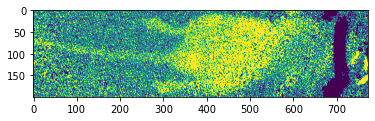

Mouse 4 slot 2


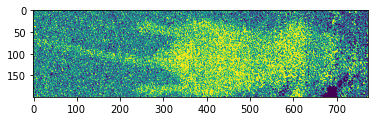

Matrix shape: (1024, 1024)
mean  8.813953
mean  16.773607
mean  21.001747
mean  22.524937
mean  9.761692
Mouse 5 slot 1


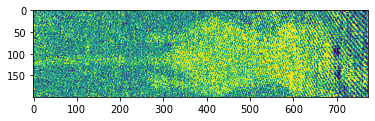

Mouse 5 slot 3


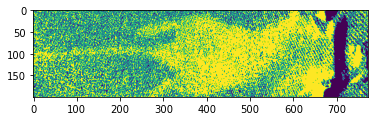

Mouse 5 slot 2


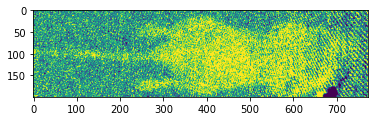

Matrix shape: (1024, 1024)
mean  2.064688
mean  3.8135135
mean  6.8972898
mean  6.081593
mean  3.320925
Mouse 6 slot 2


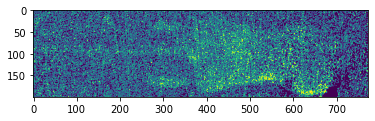

Matrix shape: (1024, 1024)
mean  7.0059466
mean  13.90877
mean  18.082933
mean  19.34541
mean  9.464605
Mouse 7 slot 1


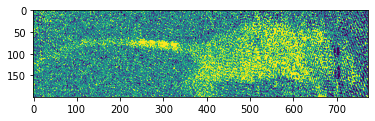

Mouse 7 slot 3


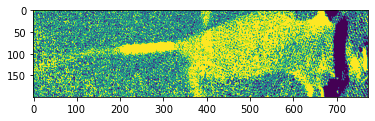

Mouse 7 slot 2


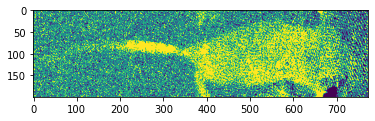

Matrix shape: (1024, 1024)
mean  2.1225052
mean  3.6058676
mean  6.1792355
mean  5.3000054
mean  3.3291152
Mouse 8 slot 2


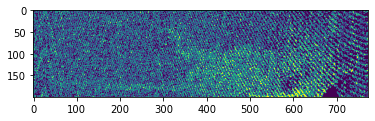

Matrix shape: (1024, 1024)
mean  7.2910004
mean  14.541572
mean  18.457054
mean  17.919294
mean  7.9357047
Mouse 9 slot 1


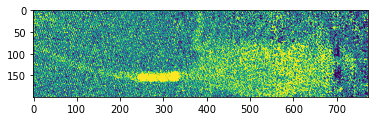

Mouse 9 slot 3


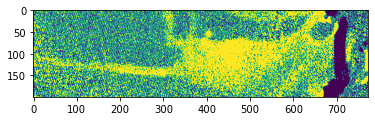

Mouse 9 slot 2


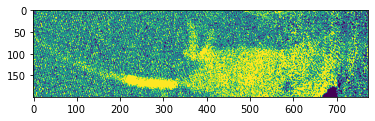

Matrix shape: (1024, 1024)
mean  2.192711
mean  3.7456787
mean  4.5296345
mean  7.811905
mean  2.8011308
Mouse 10 slot 3


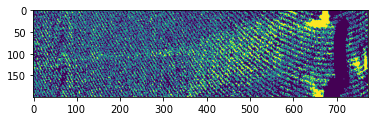

Matrix shape: (1024, 1024)
mean  5.275383
mean  11.008455
mean  13.347186
mean  12.426844
mean  5.4068317
Mouse 11 slot 1


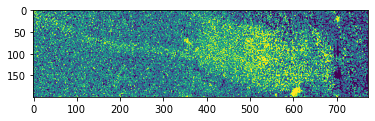

Mouse 11 slot 3


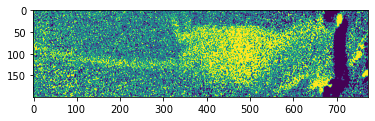

Mouse 11 slot 2


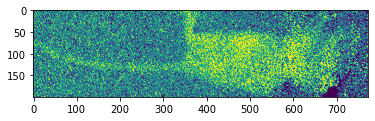

Matrix shape: (1024, 1024)
mean  10.36609
mean  17.488823
mean  20.66683
mean  19.515787
mean  10.646672
Mouse 12 slot 1


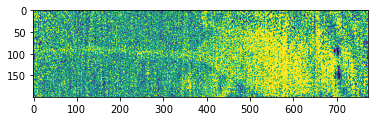

Mouse 12 slot 3


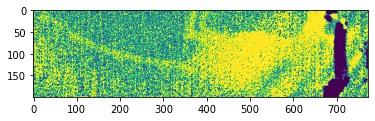

Mouse 12 slot 2


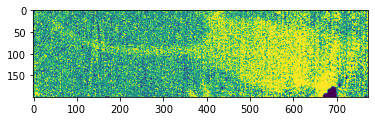

Matrix shape: (1024, 1024)
mean  6.158658
mean  11.391508
mean  13.990286
mean  15.067123
mean  6.607892
Mouse 13 slot 1


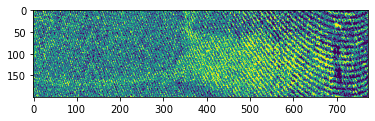

Mouse 13 slot 3


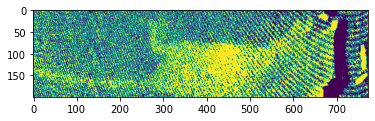

Mouse 13 slot 2


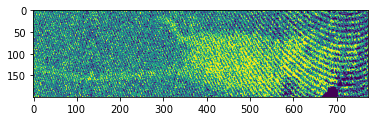

Matrix shape: (1024, 1024)
mean  7.873275
mean  15.4551735
mean  19.203333
mean  20.423077
mean  8.272495
Mouse 14 slot 1


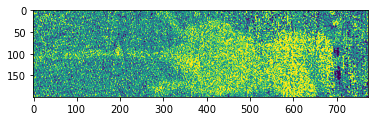

Mouse 14 slot 3


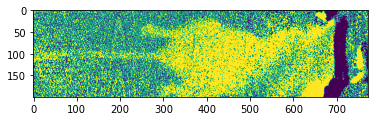

Mouse 14 slot 2


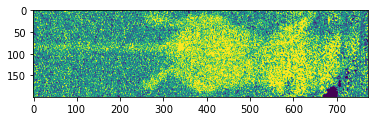

Matrix shape: (1024, 1024)
mean  6.6826863
mean  13.027233
mean  16.153769
mean  16.2779
mean  7.1270113
Mouse 15 slot 1


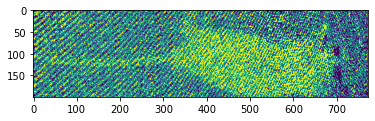

Mouse 15 slot 3


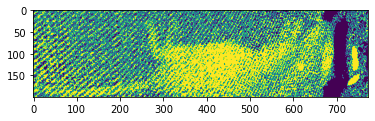

Mouse 15 slot 2


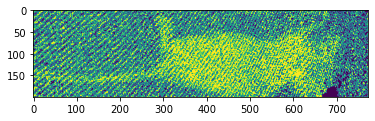

Matrix shape: (1024, 1024)
mean  2.2052665
mean  5.2108994
mean  5.5713573
mean  10.449423
mean  2.270602
Mouse 16 slot 1


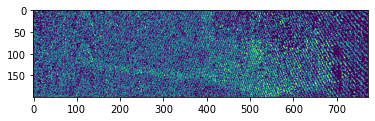

Matrix shape: (1024, 1024)
mean  9.834067
mean  17.533731
mean  22.440838
mean  21.661097
mean  11.31283
Mouse 17 slot 1


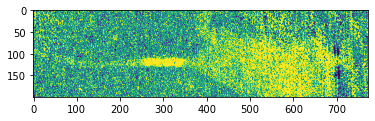

Mouse 17 slot 3


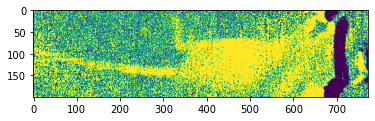

Mouse 17 slot 2


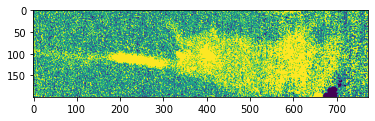

Matrix shape: (1024, 1024)
mean  7.058366
mean  7.5800567
mean  13.052332
mean  15.456868
mean  8.736524
Mouse 18 slot 4


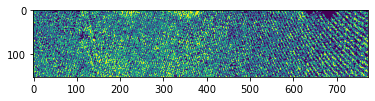

Mouse 18 slot 3


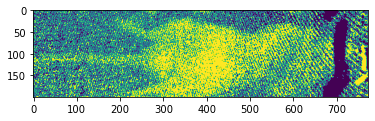

Mouse 18 slot 2


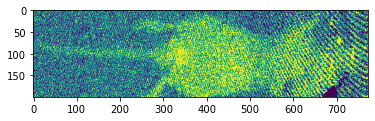

Matrix shape: (1024, 1024)
mean  2.3185985
mean  4.050186
mean  5.0209
mean  8.240164
mean  2.4361465
Mouse 19 slot 3


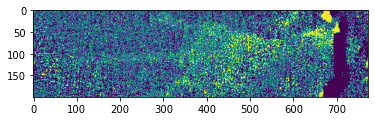

Matrix shape: (1024, 1024)
mean  7.0470085
mean  13.719445
mean  17.60229
mean  17.629692
mean  7.7165475
Mouse 20 slot 1


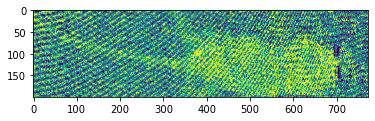

Mouse 20 slot 3


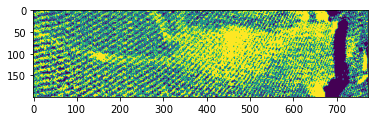

Mouse 20 slot 2


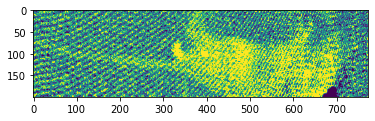

Matrix shape: (1024, 1024)
mean  2.38611
mean  3.9588568
mean  7.2894816
mean  8.620215
mean  3.73473
Mouse 21 slot 2


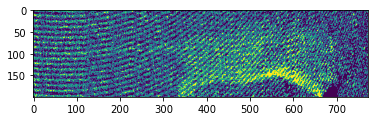

Matrix shape: (1024, 1024)
mean  6.809561
mean  12.341243
mean  14.891066
mean  15.102083
mean  7.1060643
Mouse 22 slot 1


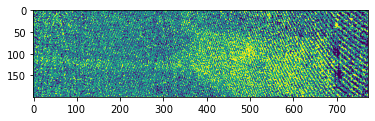

Mouse 22 slot 3


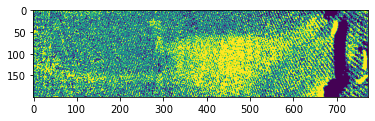

Mouse 22 slot 2


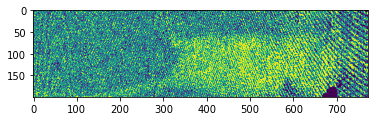

Matrix shape: (1024, 1024)
mean  7.729355
mean  13.837374
mean  16.69682
mean  16.722374
mean  7.7937303
Mouse 23 slot 1


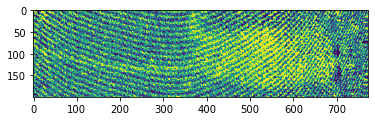

Mouse 23 slot 3


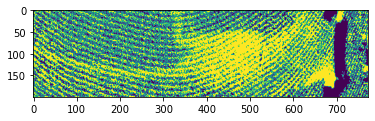

Mouse 23 slot 2


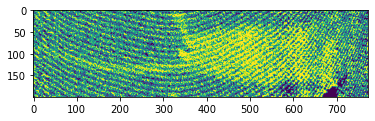

Matrix shape: (1024, 1024)
mean  11.402305
mean  18.379972
mean  21.393335
mean  19.931128
mean  11.737448
Mouse 24 slot 1


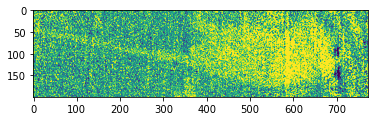

Mouse 24 slot 3


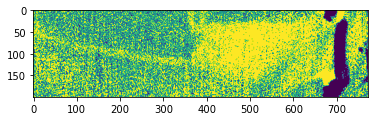

Mouse 24 slot 2


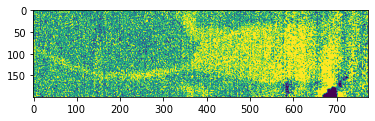

Matrix shape: (1024, 1024)
mean  5.612424
mean  8.85306
mean  14.589015
mean  14.003722
mean  5.894969
Mouse 25 slot 1


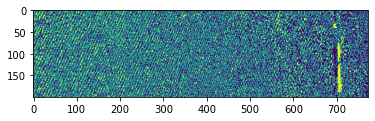

Mouse 25 slot 3


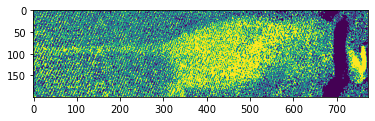

Mouse 25 slot 2


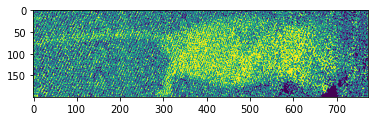

Matrix shape: (2048, 2048)
Matrix shape: (1024, 1024)
mean  6.835157
mean  11.183715
mean  15.45805
mean  30.840813
mean  7.72341
Mouse 27 slot 1


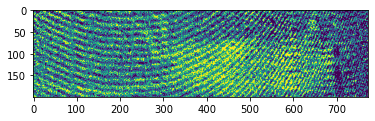

Mouse 27 slot 3


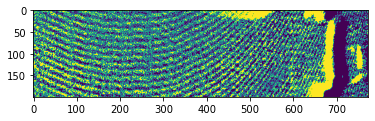

Mouse 27 slot 2


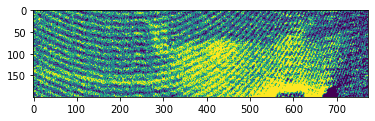

Matrix shape: (1024, 1024)
mean  5.7994184
mean  9.12486
mean  15.000637
mean  13.753417
mean  6.0020356
Mouse 28 slot 1


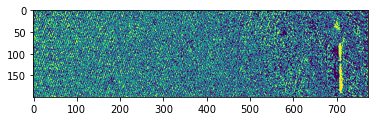

Mouse 28 slot 3


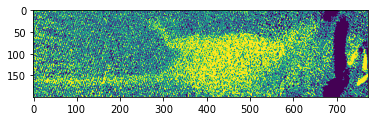

Mouse 28 slot 2


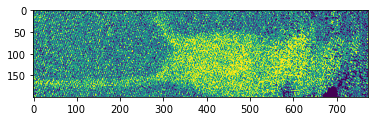

Matrix shape: (1024, 1024)
mean  2.1058764
mean  3.7200642
mean  4.6017275
mean  7.465874
mean  2.196555
Mouse 29 slot 3


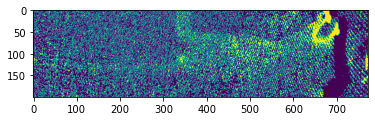

Matrix shape: (1024, 1024)
mean  6.3506813
mean  9.468618
mean  15.166971
mean  14.818915
mean  6.4860263
Mouse 30 slot 1


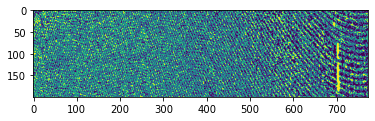

Mouse 30 slot 3


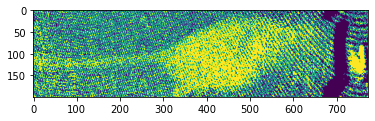

Mouse 30 slot 2


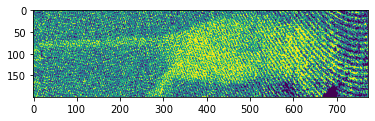

Matrix shape: (1024, 1024)
mean  6.8342514
mean  13.352827
mean  15.9201765
mean  16.03763
mean  6.969514
Mouse 31 slot 1


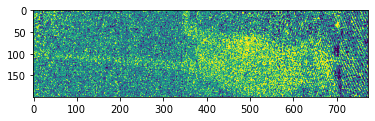

Mouse 31 slot 3


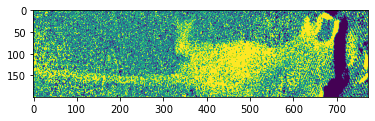

Mouse 31 slot 2


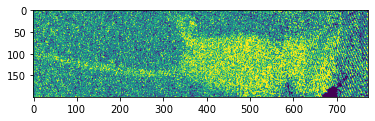

Matrix shape: (1024, 1024)
mean  10.441902
mean  17.171656
mean  20.496492
mean  19.256857
mean  10.650181
Mouse 32 slot 1


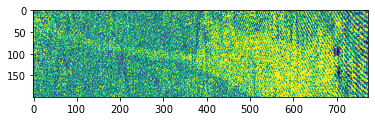

Mouse 32 slot 3


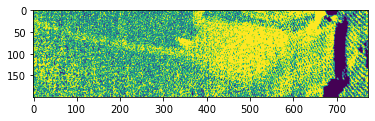

Mouse 32 slot 2


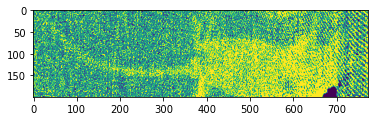

Matrix shape: (1024, 1024)
mean  7.8850856
mean  14.303655
mean  17.651436
mean  19.43323
mean  8.223799
Mouse 33 slot 1


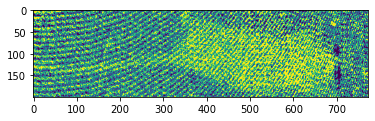

Mouse 33 slot 3


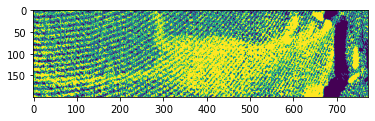

Mouse 33 slot 2


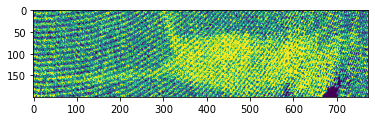

Matrix shape: (1024, 1024)
mean  11.001638
mean  17.965656
mean  21.230122
mean  20.352
mean  11.600175
Mouse 34 slot 1


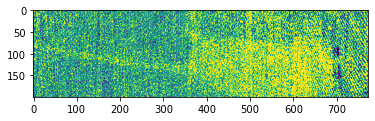

Mouse 34 slot 3


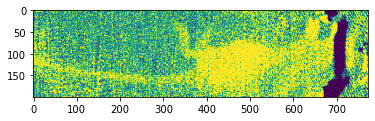

Mouse 34 slot 2


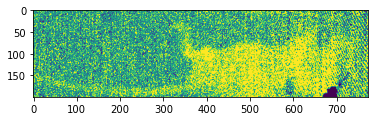

Matrix shape: (1024, 1024)
mean  7.442533
mean  13.902675
mean  16.964516
mean  23.002405
mean  8.727232
Mouse 35 slot 1


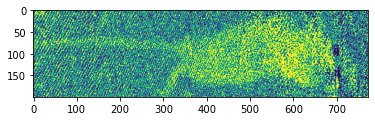

Mouse 35 slot 3


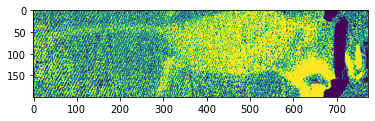

Mouse 35 slot 2


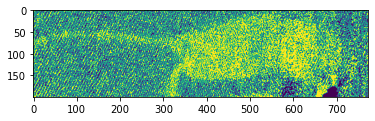

Matrix shape: (1024, 1024)
mean  7.8166065
mean  14.830938
mean  17.828224
mean  18.821123
mean  8.347493
Mouse 36 slot 1


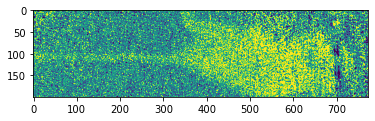

Mouse 36 slot 3


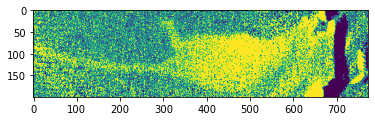

Mouse 36 slot 2


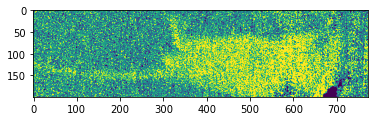

Matrix shape: (1024, 1024)
mean  6.729724
mean  11.00365
mean  16.088072
mean  29.837412
mean  8.179351
Mouse 37 slot 1


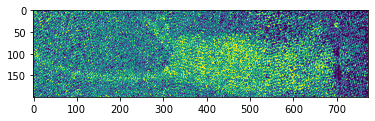

Mouse 37 slot 3


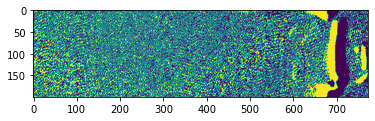

Mouse 37 slot 2


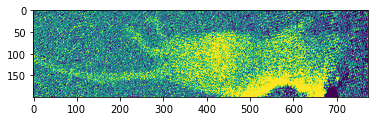

Matrix shape: (1024, 1024)
mean  6.8047323
mean  11.338509
mean  15.82765
mean  29.53207
mean  8.18257
Mouse 38 slot 1


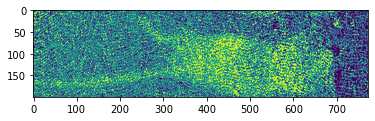

Mouse 38 slot 3


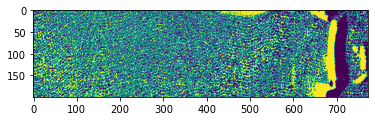

Mouse 38 slot 2


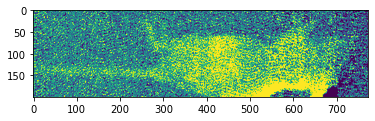

Matrix shape: (1024, 1024)
mean  2.5775182
mean  5.5231066
mean  6.335743
mean  11.499692
mean  2.871491
Mouse 39 slot 1


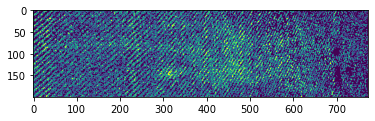

Matrix shape: (1024, 1024)
mean  6.34088
mean  9.86959
mean  15.784611
mean  16.12648
mean  6.618595
Mouse 40 slot 1


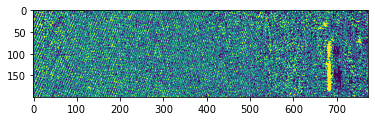

Mouse 40 slot 3


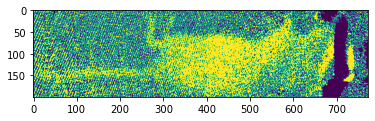

Mouse 40 slot 2


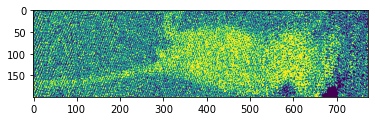

Matrix shape: (1024, 1024)
mean  6.958838
mean  14.188349
mean  19.038889
mean  25.553303
mean  10.329077
Mouse 41 slot 1


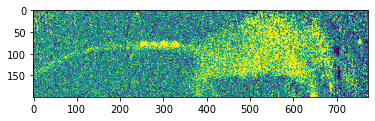

Mouse 41 slot 3


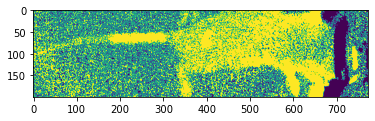

Mouse 41 slot 2


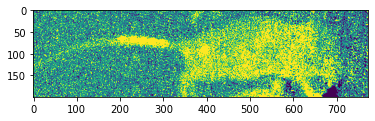

Matrix shape: (1024, 1024)
mean  2.3285716
mean  5.486581
mean  5.6187987
mean  10.938362
mean  2.605205
Mouse 42 slot 1


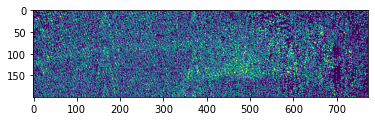

Matrix shape: (1024, 1024)
mean  9.62835
mean  16.564014
mean  20.20033
mean  20.928532
mean  10.400314
Mouse 43 slot 1


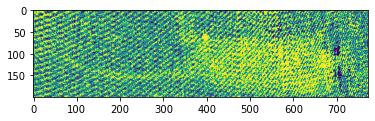

Mouse 43 slot 3


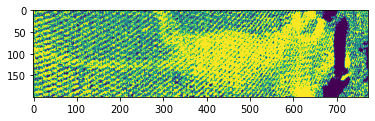

Mouse 43 slot 2


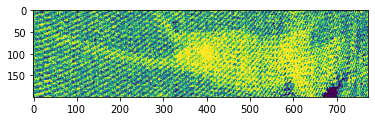

Matrix shape: (1024, 1024)
mean  8.121347
mean  14.75319
mean  18.622572
mean  17.986734
mean  8.428048
Mouse 44 slot 1


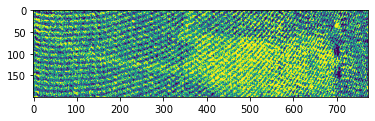

Mouse 44 slot 3


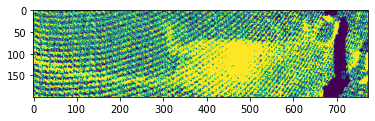

Mouse 44 slot 2


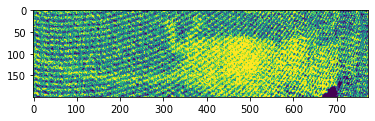

Matrix shape: (1024, 1024)
mean  6.079163
mean  9.2297735
mean  14.96631
mean  14.539674
mean  6.4207273
Mouse 45 slot 1


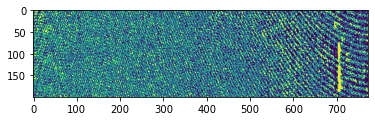

Mouse 45 slot 3


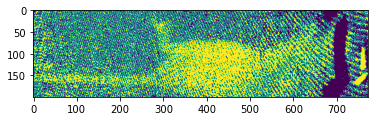

Mouse 45 slot 2


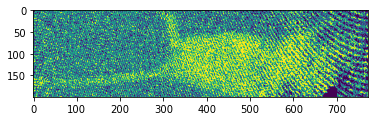

Matrix shape: (1024, 1024)
mean  8.866469
mean  16.215706
mean  19.580524
mean  18.87376
mean  9.297663
Mouse 46 slot 1


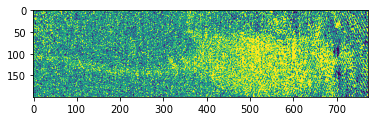

Mouse 46 slot 3


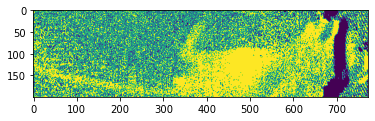

Mouse 46 slot 2


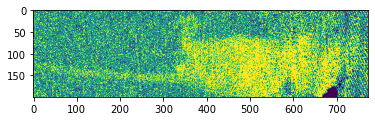

Matrix shape: (1024, 1024)
mean  11.337991
mean  18.488008
mean  21.657286
mean  21.945091
mean  12.13993
Mouse 47 slot 1


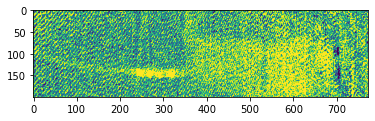

Mouse 47 slot 3


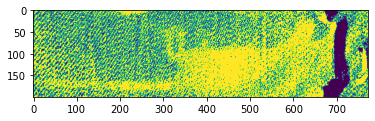

Mouse 47 slot 2


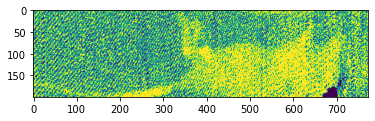

In [12]:
off = 70
background = 5
m_positions_all = [[], [], [], [], []]
bcg_mean_705 = np.zeros((len(control_files), len(positions_all)))

for j, name in enumerate(control_files):
    # load the arr
    tmp_arr = load_h5_into_np(os.path.join(all_files_path, control_files[j]))
    # loop only over correct shape
    if tmp_arr.shape == (1024, 1024):
        for i in range(5):
            y = tmp_arr[off + (200 * i) : off + (200 * (i + 1)), 250:-1]
            # correct for the given slot
            y -= correction_matrix_slots[(200 * i) : (200 * (i + 1)), :]
            # remove negative values
            y[y < 0] = 0
            #         plt.imshow(y>background)
            print("mean ", y.mean())
            bcg_mean_705[j, i] = y.mean()
        #         sns.histplot((y[y>background]).reshape(-1), ax=ax[2*j+1,i])

        if "vsechny" in name:
            # get indices of three slots with mice
            # https://stackoverflow.com/questions/6910641/how-do-i-get-indices-of-n-maximum-values-in-a-numpy-array
            inds = np.argpartition(bcg_mean_705[j, :], -3)[-3:]

            # plot full positions
            for k in inds:
                print(f"Mouse {j} slot {k}")
                z = tmp_arr[off + (200 * k) : off + (200 * (k + 1)), 250:-1]
                plt.imshow(z > background)
                plt.show()

                # get the full positions and append their values to corresponding list
                m_positions_all[k].append(z)

        elif "mys" in name:
            # get the position manually, CAUTION!!! Must be checked by a user
            k = int(name.split("_")[5][-1])
            print(f"Mouse {j} slot {k}")
            z = tmp_arr[off + (200 * k) : off + (200 * (k + 1)), 250:-1]
            plt.imshow(z > background)
            plt.show()
            # get the empty positions and append their values to corresponding list
            m_positions_all[k].append(z)

(954, 773)


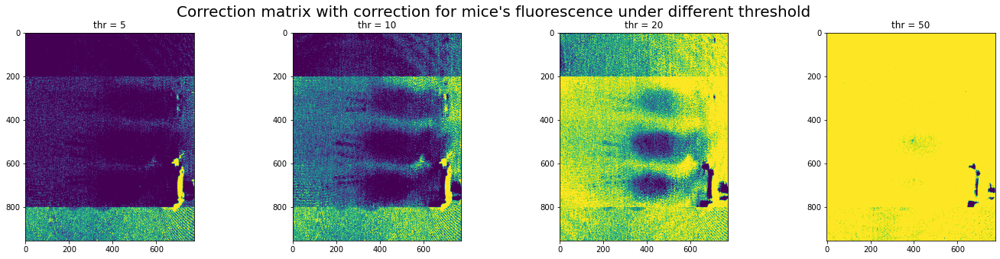

In [13]:
# create an array of means for each position if mouse exist, else use background signal
correction_matrix_slots_mice_all = np.concatenate(
    [
        np.asarray(m_positions_all[i]).mean(axis=0)
        if m_positions_all[i]
        else np.asarray(positions_all[i]).mean(axis=0)
        for i in range(len(m_positions_all))
    ]
)

print(correction_matrix_slots_mice_all.shape)

# plot the data with different thresholds
fig, axs = plt.subplots(ncols=4, figsize=(24, 5))

thr_list = [5, 10, 20, 50]

for thr, ax in zip(thr_list, axs.flatten()):
    ax.imshow(correction_matrix_slots_mice_all < thr)
    ax.set_title(f"thr = {thr}")

plt.suptitle(
    "Correction matrix with correction for mice's fluorescence under different threshold",
    fontsize=20,
)
plt.show()

<AxesSubplot:>

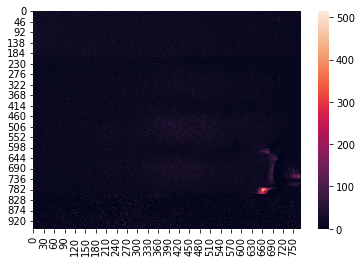

In [14]:
sns.heatmap(correction_matrix_slots_mice_all)

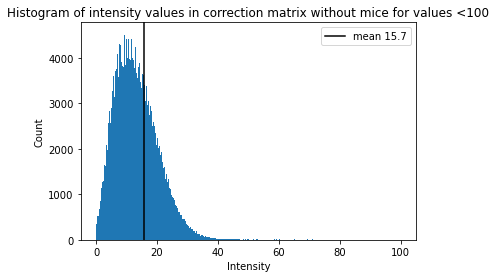

In [15]:
plot_thr = 100

plt.hist(
    correction_matrix_slots_all[
        (0 < correction_matrix_slots_all) & (correction_matrix_slots_all < plot_thr)
    ].reshape(-1),
    bins=1000,
)
plt.axvline(
    correction_matrix_slots_all.mean(),
    c="k",
    label="mean {:.3}".format(correction_matrix_slots_all.mean()),
)
plt.title(
    f"Histogram of intensity values in correction matrix without mice for values <{plot_thr}"
)
plt.xlabel("Intensity")
plt.ylabel("Count")
plt.legend()
plt.show()

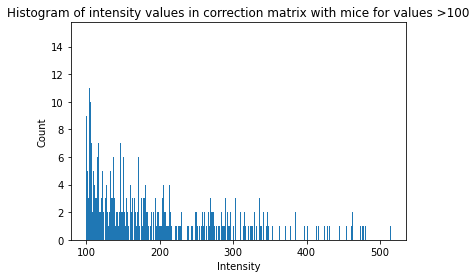

In [16]:
plt.hist(
    correction_matrix_slots_mice_all[correction_matrix_slots_mice_all > plot_thr].reshape(-1),
    bins=1000,
)
plt.title(
    f"Histogram of intensity values in correction matrix with mice for values >{plot_thr}"
)
plt.xlabel("Intensity")
plt.ylabel("Count")
plt.show()

In [17]:
# save

np.save("./correction_matrix_slots_mice_all.npy", correction_matrix_slots_mice_all)

In [18]:
%load_ext watermark

%watermark -a 'Jan Kadlec' -nmvu -iv

Author: Jan Kadlec

Last updated: Tue Apr 19 2022

Python implementation: CPython
Python version       : 3.8.11
IPython version      : 7.26.0

Compiler    : Clang 10.0.0 
OS          : Darwin
Release     : 21.4.0
Machine     : x86_64
Processor   : i386
CPU cores   : 16
Architecture: 64bit

numpy     : 1.19.1
h5py      : 3.3.0
sys       : 3.8.11 (default, Aug  6 2021, 08:56:27) 
[Clang 10.0.0 ]
matplotlib: 3.4.2
seaborn   : 0.11.1

